<a href="https://colab.research.google.com/github/HiddenFox29/-3/blob/master/Darknet_To_Colab_Alex_Fox.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


**Удаление директории darknet при конфликтах**

In [0]:
# !rm -r /content/darknet/
# !hostname -I

# **ШАГ 0. Настройка среды выполнения для работы с графическим процессором**
Мы хотим использовать аппаратное ускорение 12GB-RAM GPU !

Выберите « Меню»> «Время выполнения»> «Настроить тип времени выполнения» и выберите « Графический процессор». Из выпадающего меню « Аппаратный ускоритель»u

# ШАГ 1. Подключите свои файлы к Google Drive, устанавливаем  cuDNN
Мантируем Google Drive, проверяем версию CUDA, устанавливаем  cuDNN.

In [9]:
# This cell imports the drive library and mounts your Google Drive as a VM local drive. You can access to your Drive files 
# using this path "/content/gdrive/My Drive/"
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
# !ls
# %cd /content/gdrive/My Drive/new data for dataset
# !ls

In [0]:
# !tar -xzvf "/content/gdrive/My Drive/new data for dataset/image.tar.gz"

Теперь доступ к папке на Google Drive прямо отсюда!

Проверьте это!

In [0]:
# Not Necessary cell
# List the content of your local computer folder
# !ls -la "/content/gdrive/My Drive/darknet/"

In [0]:
# !sudo apt-get install tree

In [0]:
# !tree /content/gdrive/My\ Drive/darknet/

**Если вы хотите упростить ваши пути, вы можете использовать символическую ссылку**:

!ln -s "/content/gdrive/My Drive/darknet/" /mydrive

Тогда вы сможете получить доступ к файлам Google Диска, просто используя /mydriveпуть

**БУДЬТЕ ОСТОРОЖНЫ**: все пути в этом блокноте не используют символическую ссылку. Вы должны будете помнить, чтобы изменить путь везде

In [0]:
# Uncomment if you want to use Symbolic link
#!ln -s /content/gdrive/My\ Drive/darknet/ /mydrive
#!ls /mydrive

**ШАГ 2. Проверьте версию выпуска CUDA**
Nvidia CUDA предустановлена ​​на ноутбуки Colab. Теперь мы проверим установленную версию.

ВНИМАНИЕ: Возможно, какое-то время после того, как я напишу эти строки (9 апреля 2019 г.), версия CUDA будет обновлена ​​на Colab, и вы должны загрузить другую версию cuDNN на следующем шаге. Сейчас это версия 10.0, и мы используем cuDNN (cudnn-10.0-linux-x64-v7.6.4.38.tgz) соответственно

In [10]:
# This cell can be commented once you checked the current CUDA version
# CUDA: Let's check that Nvidia CUDA is already pre-installed and which version is it. In some time from now maybe you 
!/usr/local/cuda/bin/nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2019 NVIDIA Corporation
Built on Sun_Jul_28_19:07:16_PDT_2019
Cuda compilation tools, release 10.1, V10.1.243


ШАГ 3. Установите cuDNN в соответствии с текущей версией CUDA
Теперь вам нужно скачать cuDNN с веб-сайта Nvidia. Вам нужно будет зарегистрироваться на сайте.

Скачать cuDNN с сайта Nvidia

Прямо сейчас, поскольку у нас CUDA 10.0 предустановлена ​​во время выполнения Colab, вам нужно скачать cuDNN v7.6.4.38 для CUDA v10.0 - файл cudnn-10.0-linux-x64-v7.6.4.38.tgz
На вашем локальном компьютере создайте папку с именем cuDNN в вашей локальной папке darknet . Скопируйте туда файл tgz

In [12]:
# We're unzipping the cuDNN files from your Drive folder directly to the VM CUDA folders
!tar -xzvf "/content/gdrive/My Drive/darknet/cuDNN/cudnn-10.0-linux-x64-v7.6.4.38.tgz" -C /usr/local/
!chmod a+r /usr/local/cuda/include/cudnn.h

# Now we check the version we already installed. Can comment this line on future runs
!cat /usr/local/cuda/include/cudnn.h | grep CUDNN_MAJOR -A2

cuda/include/cudnn.h
cuda/NVIDIA_SLA_cuDNN_Support.txt
cuda/lib64/libcudnn.so
cuda/lib64/libcudnn.so.7
cuda/lib64/libcudnn.so.7.6.4
cuda/lib64/libcudnn_static.a
#define CUDNN_MAJOR 7
#define CUDNN_MINOR 6
#define CUDNN_PATCHLEVEL 4
--
#define CUDNN_VERSION (CUDNN_MAJOR * 1000 + CUDNN_MINOR * 100 + CUDNN_PATCHLEVEL)

#include "driver_types.h"


# **ШАГ 4-А. Клонирование и компиляция Darkent. ТОЛЬКО НЕОБХОДИМО, ЧТОБЫ РАБОТАТЬ НА ПЕРВОЙ СТАДИИ!**
На этом шаге мы клонируем darknet репо и скомпилируем его.

Клон Репо
Скомпилировать Darknet
Скопировать скомпилированную версию на диск
Когда компиляция заканчивается, ваша последняя строка вывода должна выглядеть примерно так:

_ g++ -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCVpkg-config --cflags opencv-DGPU (...)_

In [0]:
# Leave this code uncommented on the very first run of your notebook or if you ever need to recompile darknet again.
# Comment this code on the future runs.
# !git clone https://github.com/kriyeng/darknet/
# %cd darknet

# Check the folder
# !ls

# I have a branch where I have done the changes commented above
# !git checkout feature/google-colab

#Compile Darknet
# !make

#Copies the Darknet compiled version to Google drive
# !cp -R /content/darknet /content/gdrive/My\ Drive/darknet/

# **ШАГ 4-Б. Копирование скомпилированной версии Darknet с диска. ОТКРЫТИЕ ПОСЛЕ ПЕРВОГО ИСПОЛНЕНИЯ**
Скопируйте скомпилированную версию darknet с диска на виртуальную машину.

Сделайте локальную папку darknet
Скопируйте файл даркнета
Установить разрешения на выполнение

In [13]:
# # Copy the Darkent compiled version to the VM local drive
!cp -R /content/gdrive/My\ Drive/darknet/ /content/darknet
%cd /content/darknet/
# # Set execution permissions to Darknet
!chmod 755 ./darknet

cp: cannot overwrite non-directory '/content/darknet/darknet' with directory '/content/gdrive/My Drive/darknet/'
/content/darknet


**Проверяем установленые прва для ./darknet**

In [14]:
!ls -l

total 3251220
drwx------ 4 root root       4096 Nov 21 05:56 3rdparty
-rw------- 1 root root       5899 Nov 21 05:56 appveyor.yml
drwx------ 3 root root       4096 Nov 21 05:57 backup
-rw------- 1 root root      85260 Nov 21 05:57 bad.list
drwx------ 3 root root       4096 Nov 21 05:56 build
-rw------- 1 root root       8163 Nov 21 05:56 build.ps1
-rw------- 1 root root       2886 Nov 21 05:56 build.sh
drwx------ 4 root root       4096 Nov 21 05:57 cfg
drwx------ 3 root root       4096 Nov 21 05:56 cmake
-rw------- 1 root root      17356 Nov 21 05:56 CMakeLists.txt
-rw------- 1 root root       6380 Nov 21 05:56 CMakeSettings.json
drwx------ 2 root root       4096 Nov 21 05:56 cuDNN
-rwxr-xr-x 1 root root    3221752 Nov 21 05:57 darknet
-rw------- 1 root root       1254 Nov 21 05:56 DarknetConfig.cmake.in
-rw------- 1 root root      16255 Nov 21 05:56 darknet.py
-rw------- 1 root root       4010 Nov 21 05:56 darknet_video.py
drwx------ 4 root root       4096 Nov 21 05:57 data
drwx------

# ШАГ 5. Проверка darknet
Давай проверим это!

Если вы запускаете этот ноутбук в первый раз, вы можете запустить следующие ячейки, чтобы проверить, все ли идет как положено!

# Некоторые утилиты
**Стоит прогрузить заранее т.к используются для отображения фото с детект объектами** 

Давайте добавим несколько утилит, которые могут быть полезны.

Эти утилиты являются:

imgShow () - поможет нам показать изображение на удаленной виртуальной машине
download () - позволит вам получить файл из вашего блокнота на случай, если
upload () - вы можете загружать файлы в вашу текущую папку на удаленной виртуальной машине.
Спасибо Ивану Гончарову за этих помощников!

In [0]:
#download files
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
#   plt.rcParams['figure.figsize'] = [3, 2]
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()
  
  
def upload():
  from google.colab import files
  uploaded = files.upload() 
  for name, data in uploaded.items():
    with open(name, 'wb') as f:
      f.write(data)
      print ('saved file', name)
def download(path):
  from google.colab import files
  files.download(path)

In [0]:
# Not necessary cell
# Get yolov3 weights
!wget https://pjreddie.com/media/files/yolov3.weights

 **ПРИМЕЧАНИЕ** . Следующий тест будет работать только тогда, когда darknet скомпилирован во время выполнения. Эта демонстрация использует некоторые данные из оригинальных папок darknet. Для ваших проектов обнаружения объектов эти необходимые файлы будут находиться в вашей локальной папке..

In [0]:
# Not necessary cell
# Execute darknet using YOLOv3 model with pre-trained weights to detect objects on 'person.jpg'
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3_last.weights" "/content/gdrive/My Drive/darknet/test/123.jpeg" -dont-show
# Show the result using the helper imgShow()
imShow('predictions.jpg')

**Должно появится изображение с выделенными объектами**
Значит darknet скомпилирован и работает исправно

# **ЧАСТЬ 2. Тренировка YOLOv3 подготовка и рекомендации**
ОТКРЫТЬ: Каждый раз, когда вы хотите запустить все свои ячейки автоматически, вы можете перейти к > Меню> Время выполнения> Запустить все . Может быть, вы не хотите выполнять весь блокнот. Вы можете написать следующую ячейку, в которой хотите остановить процесс и откомментировать assert Falseкоманду. Это выдаст ошибку и остановит запуск большего количества ячеек.




In [0]:
# don't go beyond here with Run All
#assert False

## **ЧАСТЬ 2. ШАГ 0. Подготовка ваших данных и файлов конфигурации. "шпаргалка"**

Before going further let's take a look at what configuration files you need to have in your local drive _`darknet`_

![Yolov3 configuration files cheat sheet.jpg](http://blog.ibanyez.info/download/B20190410T000000072.png)

You can download the cheat sheet [here](http://blog.ibanyez.info/download/B20190410T000000072.png)

If you need deeper explanations on how to prepare your data sets, annotation and deep learning, visit [How to train YOLOv3 using Darknet framework and optimize the VM runtime load times](post link)


>**Важно**: Вы должны тщательно настраивать пути в ваших конфигурационных файлах. В файле obj.data должны быть пробелы на пути, экранированном с помощью \ . Вот так : / content / gdrive / My \ Drive / darknet / train.txt . Но в файлах train.txt и test.txt нет!




## ЧАСТЬ 2. ШАГ 1. Загрузка файлов на локальный диск ВМ
Скорость сети между Google Drive и Colab VM может влиять на скорость вашего обучения при доступе к изображениям набора данных.

У вас может быть 3 возможных подхода в зависимости от размера вашего набора данных.

ПРИМЕЧАНИЕ. Этот шаг необязателен для всех файлов конфигурации и весов. Доступ к ним можно получить непосредственно с Google Диска без значительных проблем с производительностью. Этот шаг предназначен только для изображений и аннотаций набора данных.

**Вариант 1** - Вы можете попробовать использовать файлы непосредственно из img/папки Google Drive . В зависимости от вашего набора данных это может быть более чем хорошо.

**Вариант 2**. Перед началом обучения скопируйте ваш набор данных из Google Drive в локальную файловую систему виртуальной машины. Может быть, хорошей практикой будет скопировать как один файл tar и распаковать в вашу локальную img/папку VM

**Вариант 3** - Если ваш набор данных довольно большой, возможно, вы можете загрузить его в репозиторий git и клонировать отсюда. Обычно время переноса между ними намного лучше. Если вам нужно решить, у меня есть ощущение, что битбакет имеет лучшее время передачи по скорости, чем github, но, пожалуйста, не принимайте это как подтверждение, я не проводил специальных тестов по этому поводу , я могу ошибаться!




**ЧАСТЬ 2. ШАГ 1 - Вариант 1. Использование файлов с Google Drive напрямую.**
Вам не нужно ничего делать здесь. Ваш train.txt должен иметь правильный путь:

/ content / grdive / Мой диск / darknet / img / image001.jpg . Как уже было сказано, не используйте экранированные пробелы для путей в train.txt и test.txt

**ЧАСТЬ 2. ШАГ 1 - Вариант 2А. Копирование файлов с Google Drive на локальную файловую систему ВМ.**
Выполните следующую ячейку, чтобы скопировать ваши файлы

In [0]:
# Copy fils from Google Drive to the VM local filesystem
# !cp -r "/content/gdrive/My Drive/darknet/img" ./img

**ЧАСТЬ 2. ШАГ 1 - Вариант 2B. Копирование файлов, заархивированных с Google Drive, в локальную файловую систему VM и разархивирование локально**
Выполните следующую ячейку, чтобы скопировать ваши файлы и распаковать. Вы можете использовать команду ! Ls, чтобы выяснить, какой правильный путь вы должны настроить в вашем train.txt для правильного доступа к изображениям набора данных.

In [0]:
#  !ls
%cd /content/gdrive/My Drive/darknet
!ls -l


In [0]:
# Copy your compressed file
!cp -r "/content/gdrive/My Drive/darknet/new_img/image.tar.xz" "/content/gdrive/My Drive/darknet/" 
# Uncompress zipped file for .gz
# !tar -xzvf image.tar.gz
# Uncompress zipped file for .xz
!tar -xvf image.tar.xz

**ЧАСТЬ 2. ШАГ 1 - Вариант 3. Клонируйте ваш набор изображений из репозитория git.** 
Кажется, самый быстрый.
Выполните следующую ячейку, чтобы клонировать репозиторий набора данных в локальную файловую систему ВМ.

In [0]:
# Git clone directly to ./img folder
#!git clone https://[your-repository] ./img

# Check the result - Uncomment when you checked for speed up further runs
#!ls -la ./img

# **Переход в директорию darknet для запуска скрипта**

In [16]:
%cd /content/darknet
!ls

/content/darknet
3rdparty		data		       README.md
appveyor.yml		image		       results
backup			image.tar.xz	       scripts
bad.list		image_yolov2.sh        src
build			image_yolov3.sh        test
build.ps1		img		       testimg
build.sh		img_test	       test.txt
cfg			include		       train.txt
cmake			json_mjpeg_streams.sh  vdeo_out
CMakeLists.txt		LICENSE		       video_input
CMakeSettings.json	Makefile	       video_v2.sh
cuDNN			net_cam_v3.sh	       video_yolov3.sh
darknet			new_img		       weights
DarknetConfig.cmake.in	obj		       yolo-coco
darknet.py		obj.data	       yolo_video.py
darknet_video.py	obj.names


# **ЧАСТЬ 3. Тренируем свою модель!**
Когда вы выполните следующую команду, ваша модель начнет тренироваться.

У вас будет журнал для каждой эпохи. На каждой итерации вы увидите, как проходит ваше обучение.

**ВАЖНО**: Darknet копирует резервную копию ваших обученных весов каждые 100 итераций. Как по волшебству, этот файл будет синхронизироваться с вашим локальным диском на вашем компьютере, а также резервные копии, создаваемые darknet каждые 1000 итераций, сохраняя их в отдельном файле.

In [0]:
# !./darknet detector train "/content/gdrive/My Drive/darknet/obj.data" "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/weights/darknet53.conv.74" -dont_show -mjpeg_port 8090 -map

-**СОВЕТЫ И РЕЗУЛЬТАТЫ**
Speed up load times of the runtime: When everything is checked that works, you can remove cells or comment unnecessary lines of code to make your loading time lower on every run.

How to keep your notebook alive for more time?: Keep you browser with your notebook open. If you close your browser, your notebook will reach the iddle time and will be removed from Colab cloud Service. (90 minutes)

Перезапустите тренировку после достижения ограничения времени выполнения Colab (12 часов):

Откройте новый блокнот или подключите текущий.
Прокомментируйте ячейку выше и раскомментируйте ячейку ниже.
На локальном компьютере скопируйте файл backup / yolov3_last.weights на вес вашего локального компьютера /
Выполнить Выполнить все в > меню> Время выполнения> Выполнить все
Шаг копирования не является абсолютно необходимым, но я хотел бы сохранить копию последнего сеанса обучения и не перезаписывать этот файл на следующих занятиях.

In [19]:
# Start training at the point where the last runtime finished
!./darknet detector train "/content/gdrive/My Drive/darknet/obj.data" "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_last.weights" -dont_show -map

./darknet: error while loading shared libraries: libcudart.so.10.0: cannot open shared object file: No such file or directory


# **Проверка модели на изображениях в test, вывод статистики в фаил result.txt**
Фаил result.txt находится в директории results

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

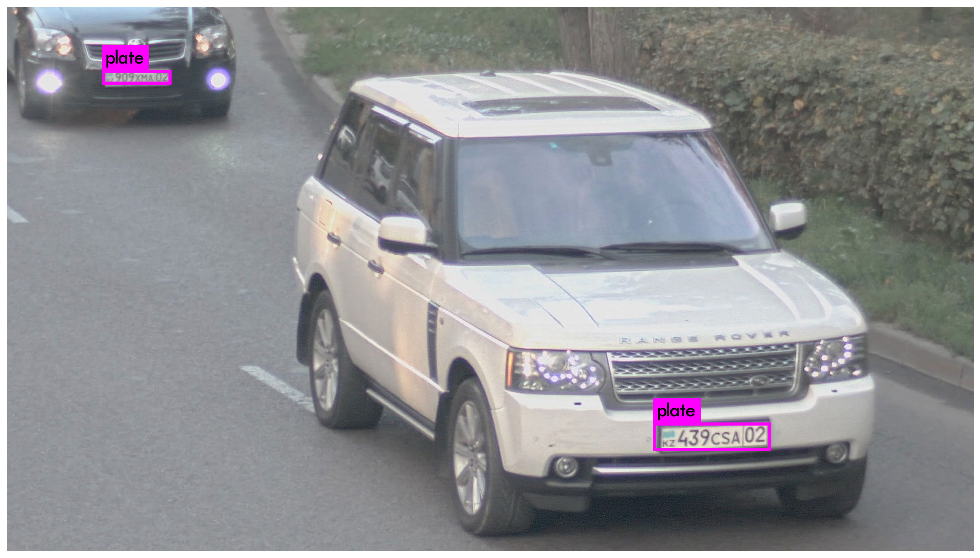

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

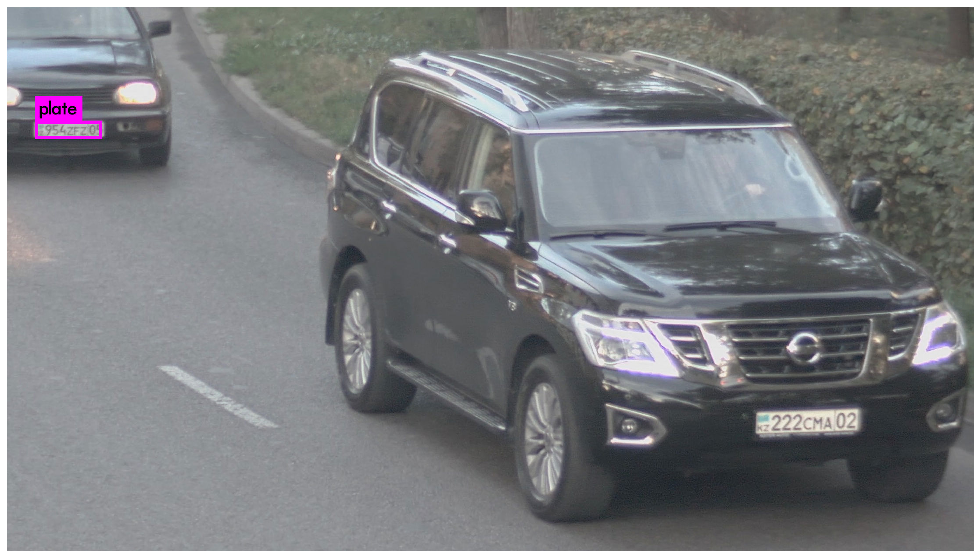

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

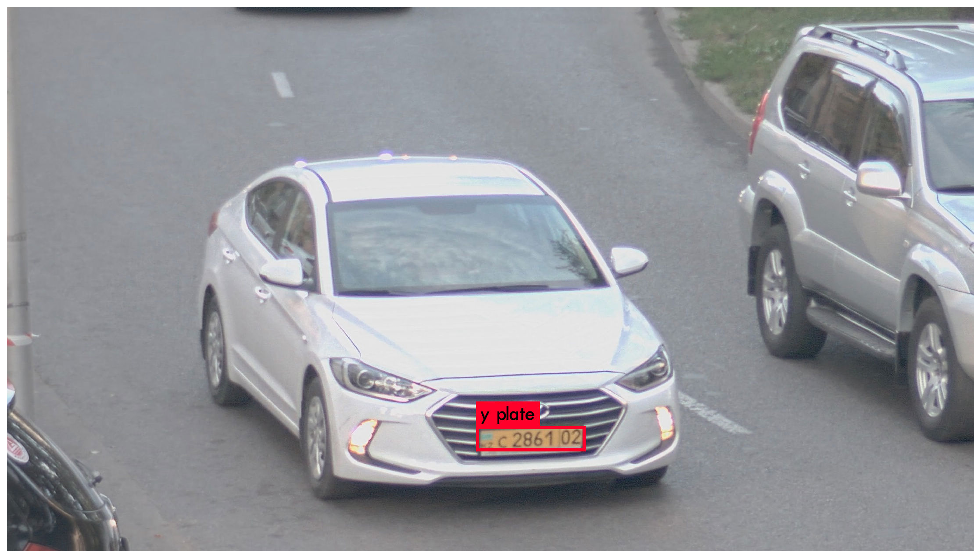

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

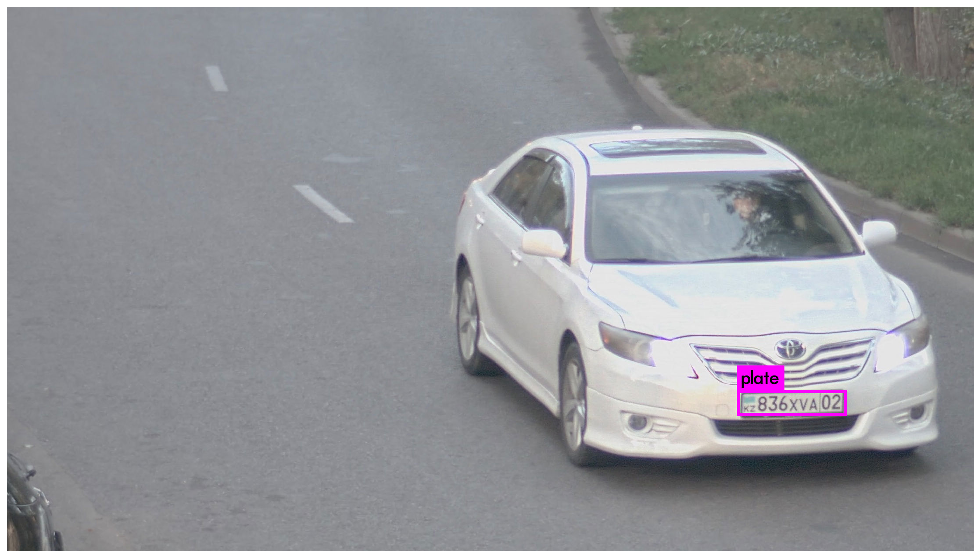

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

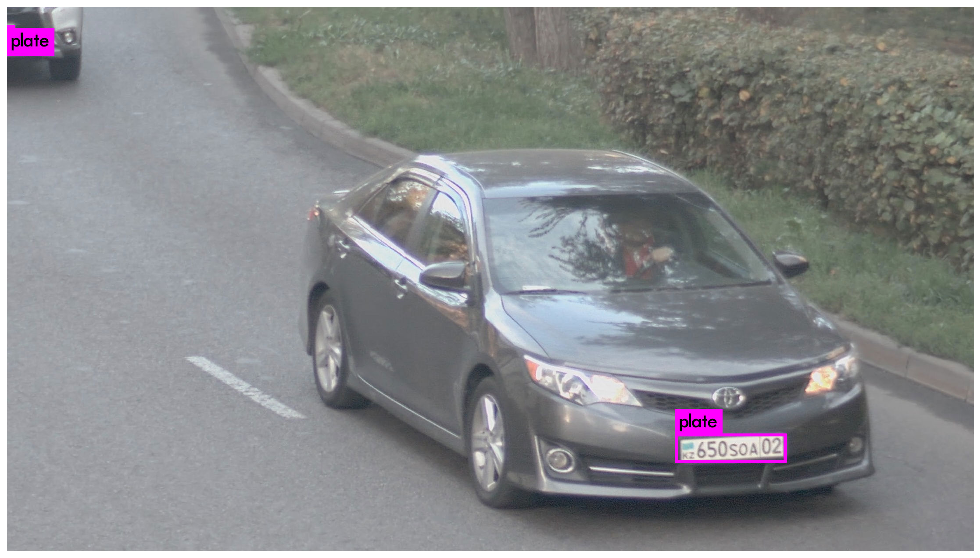

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

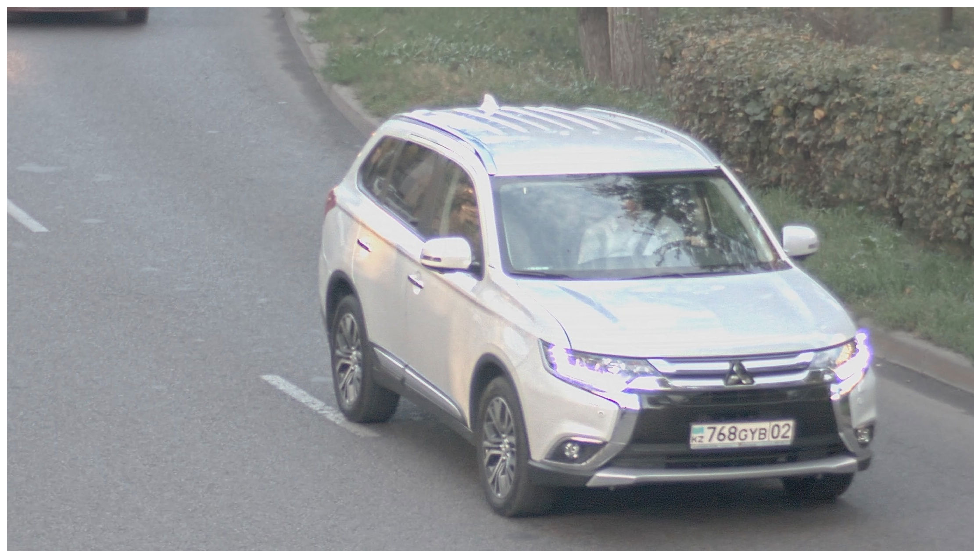

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

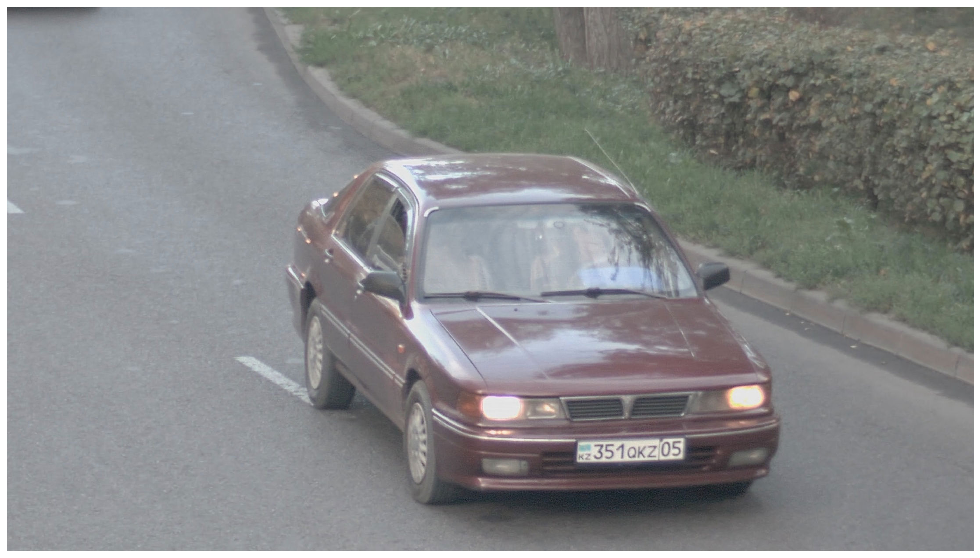

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

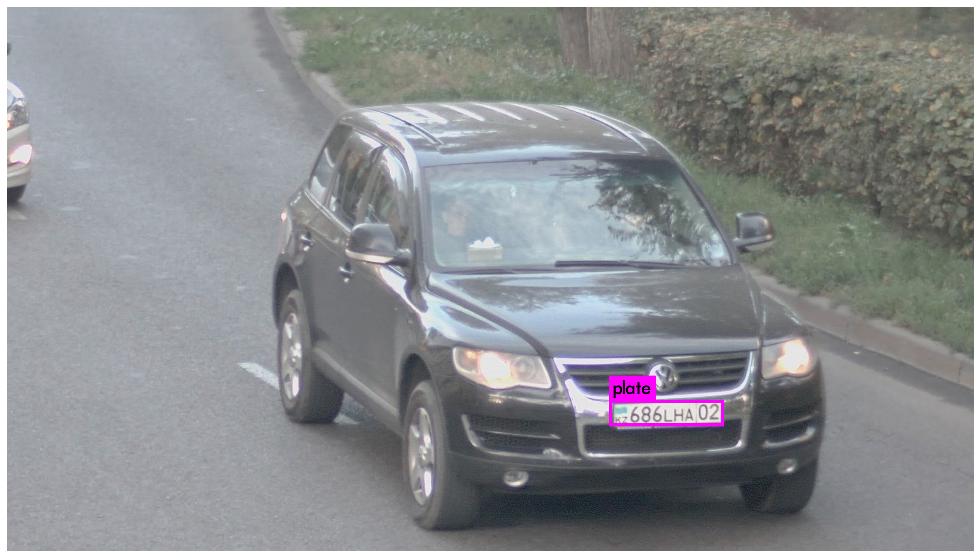

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

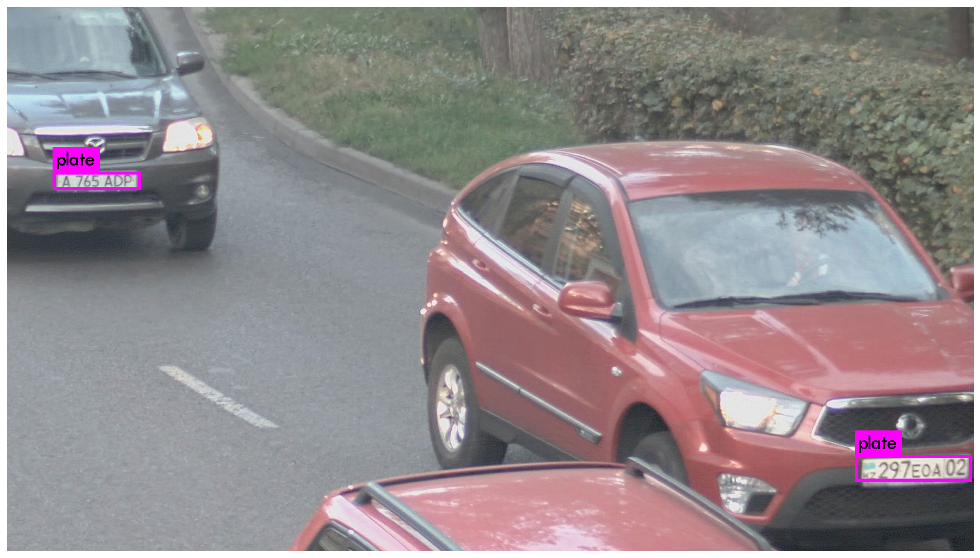

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

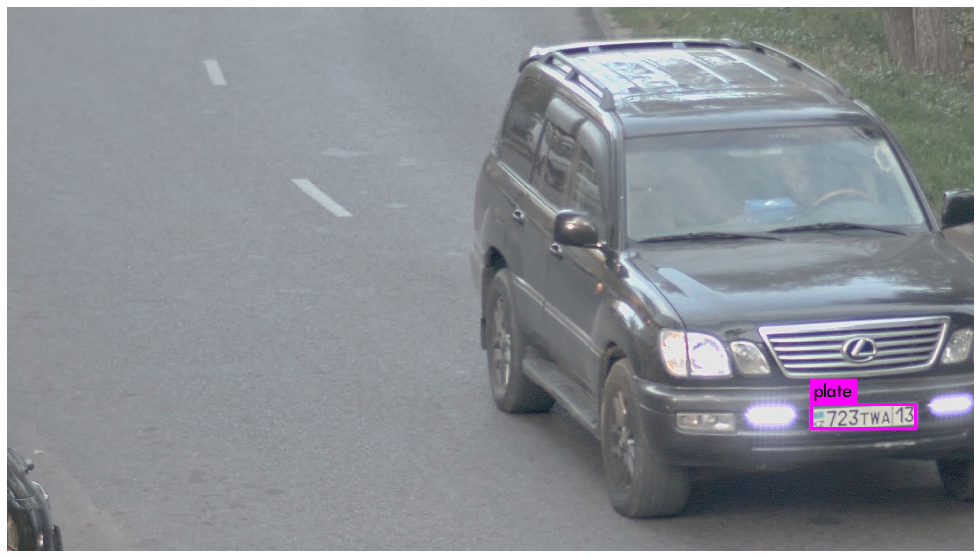

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

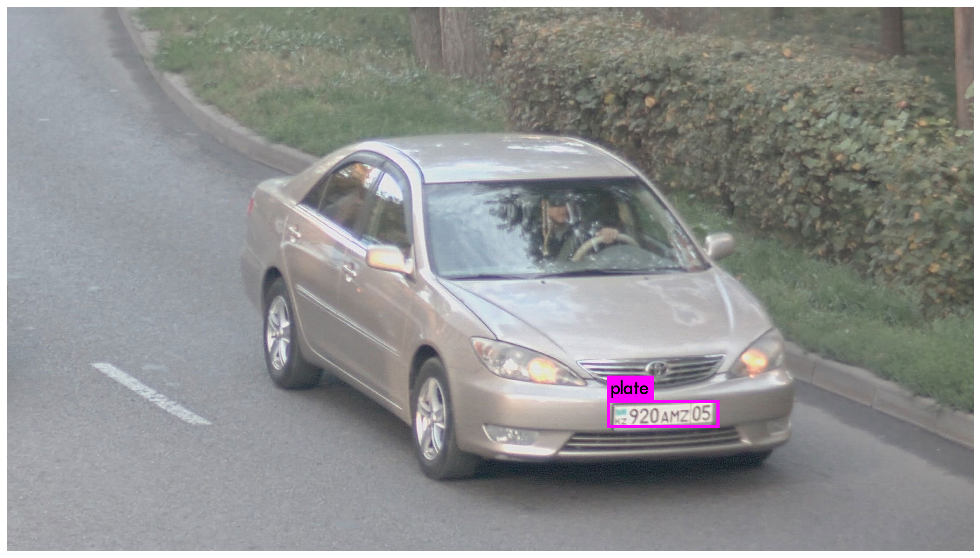

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

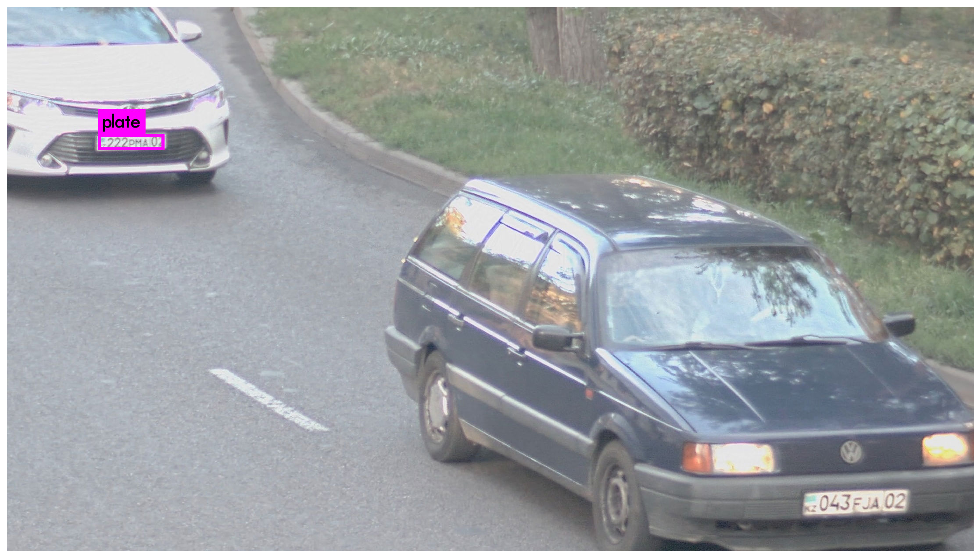

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

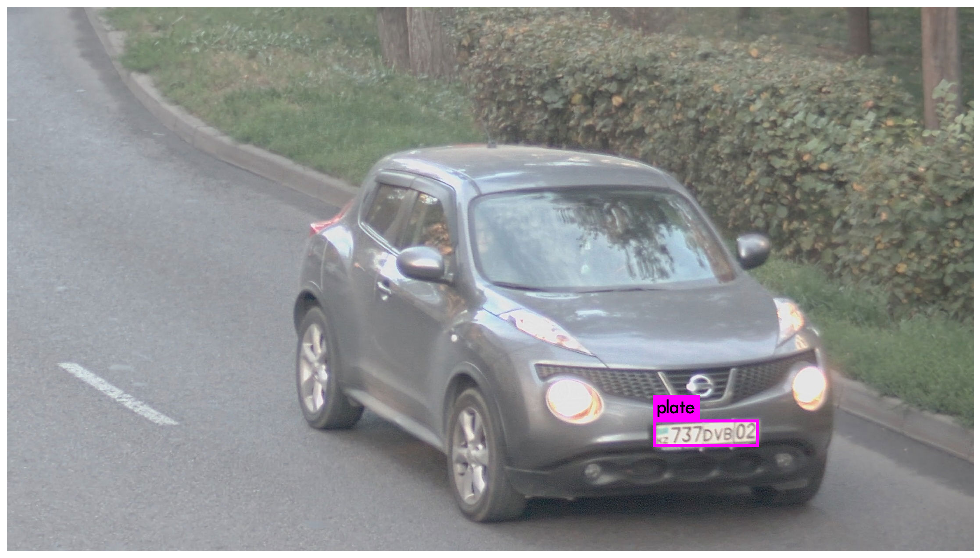

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

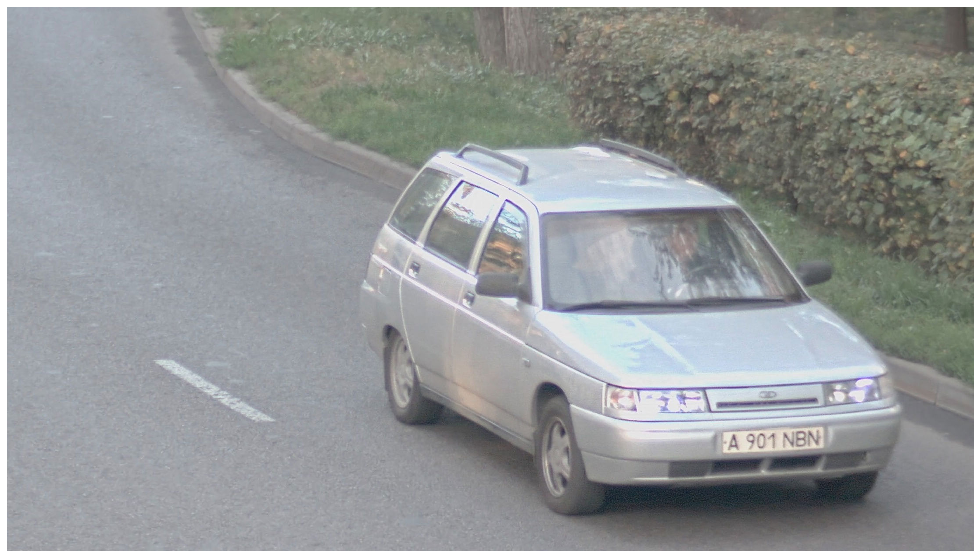

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

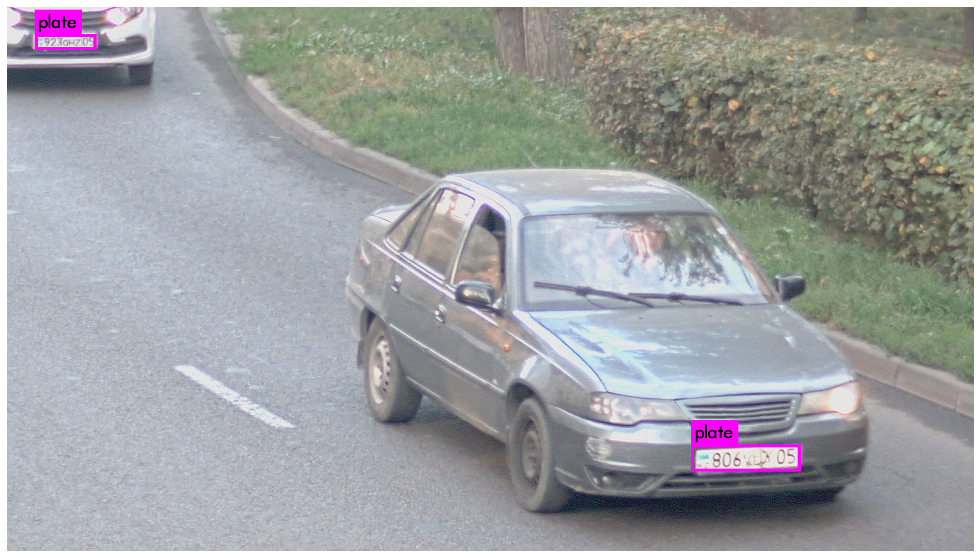

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

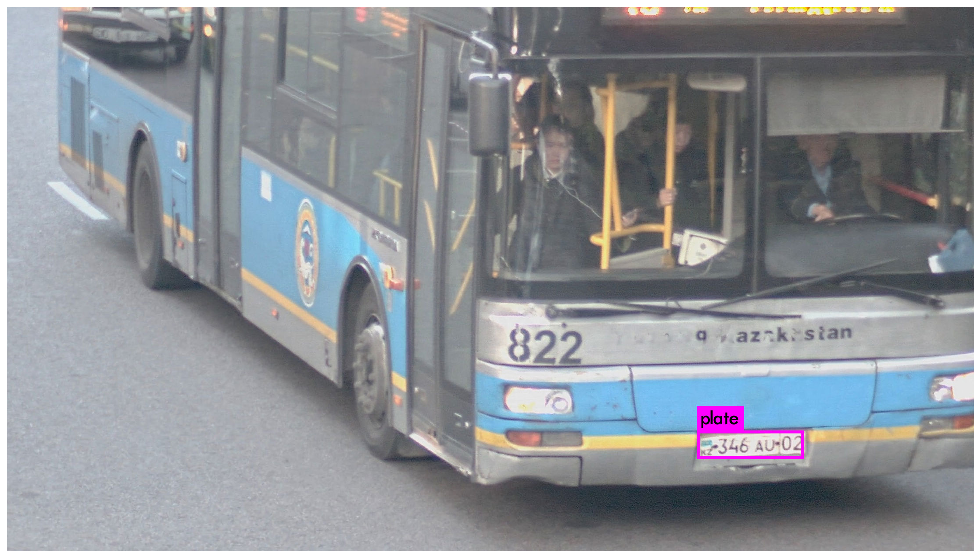

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

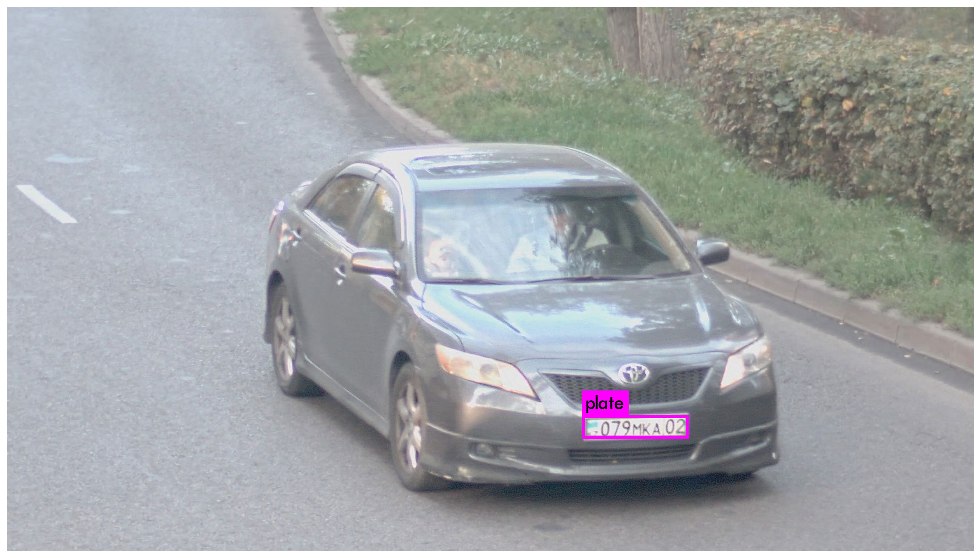

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

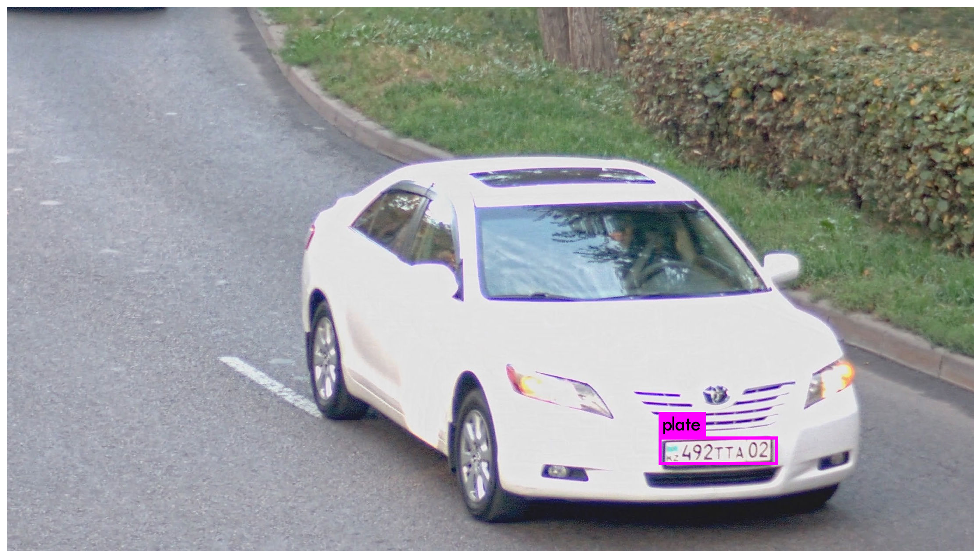

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

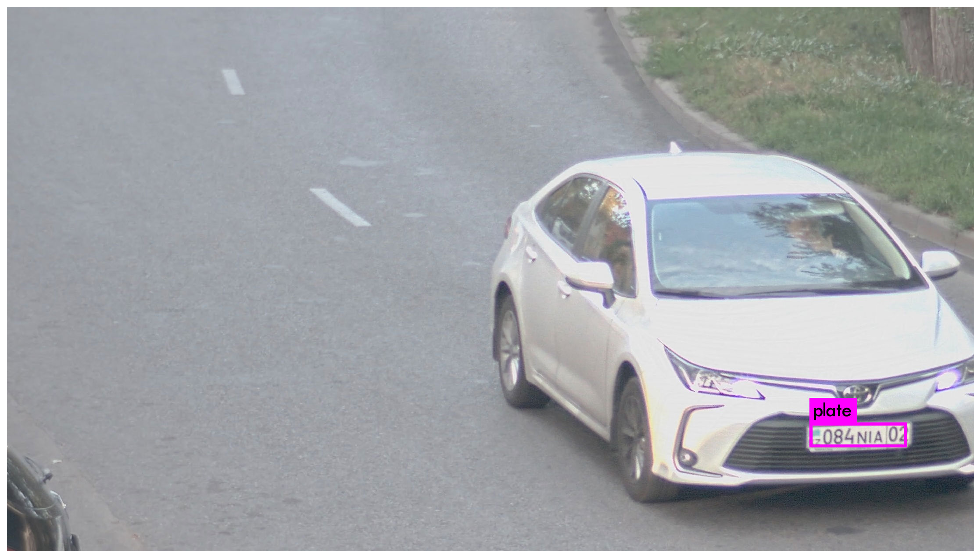

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

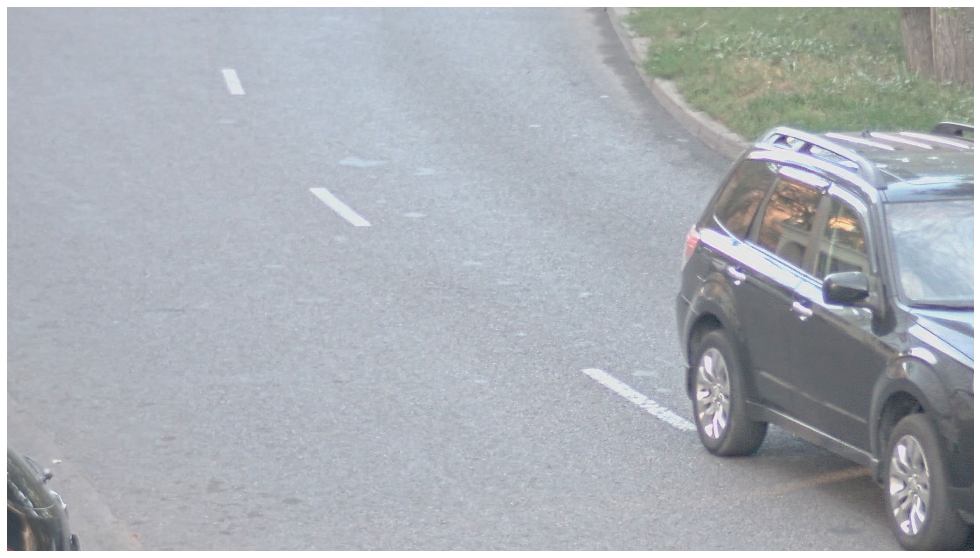

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

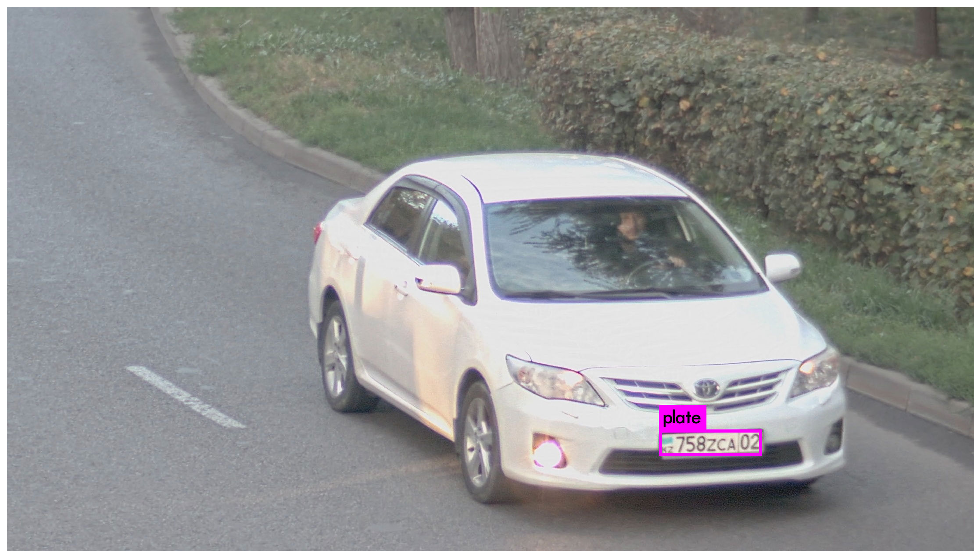

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

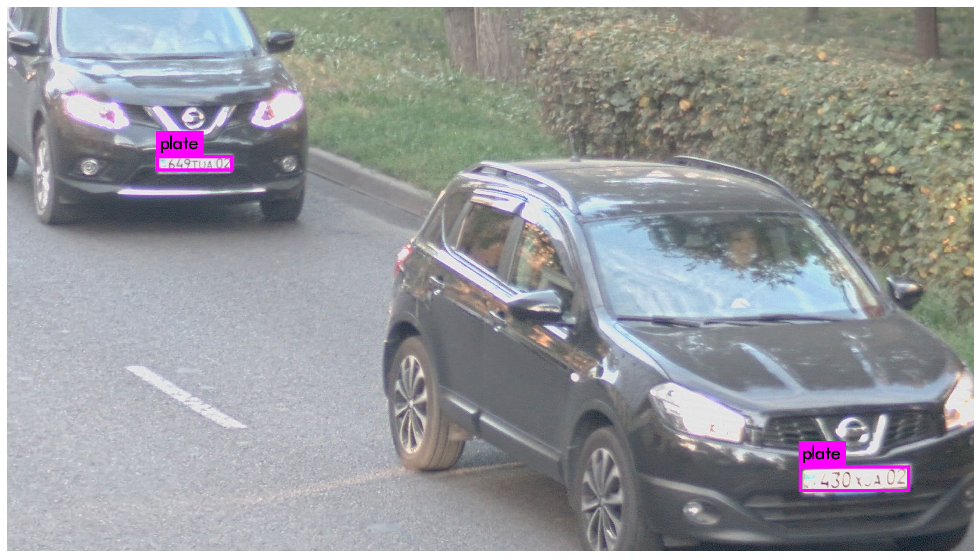

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

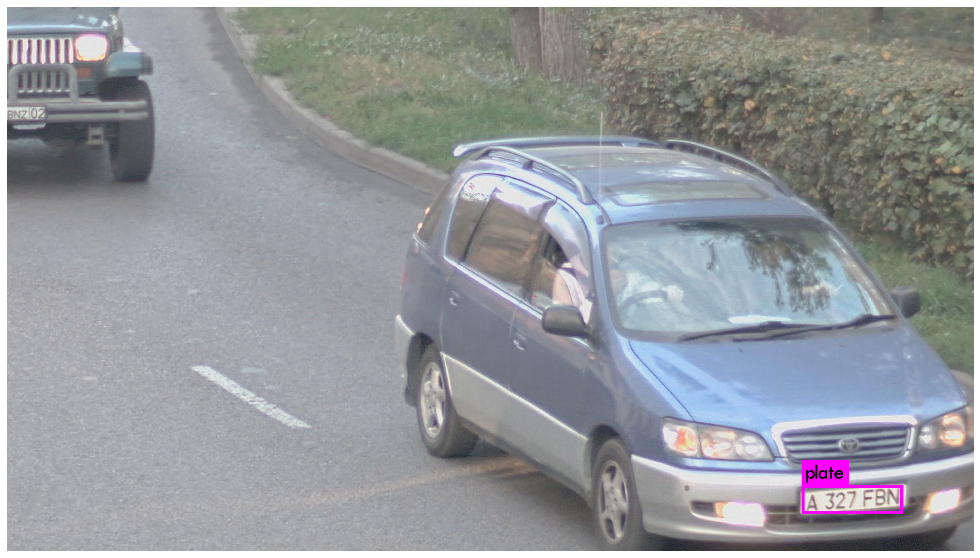

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

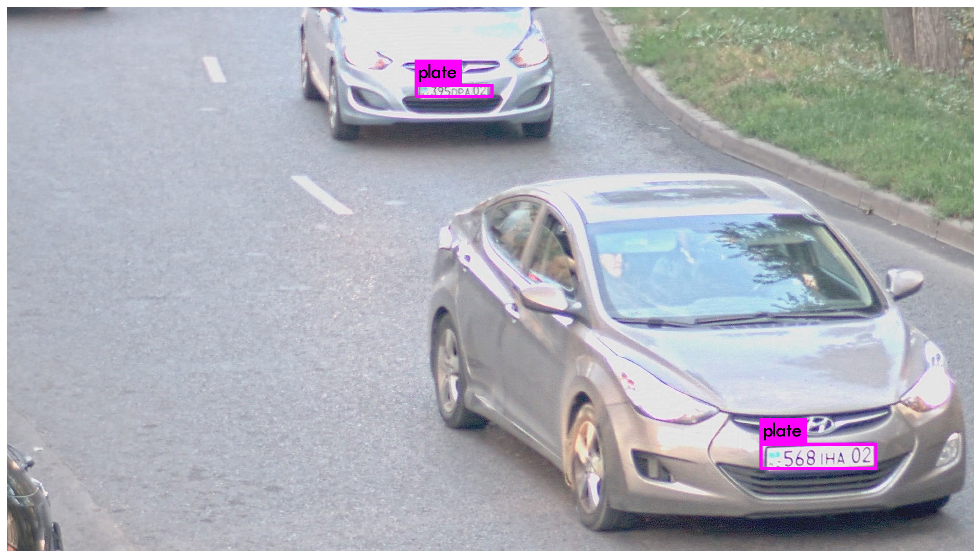

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

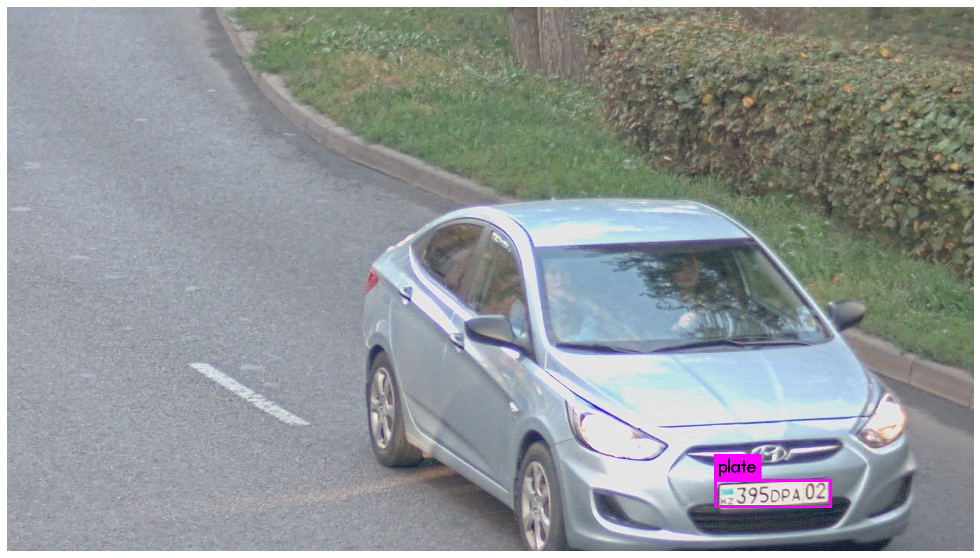

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

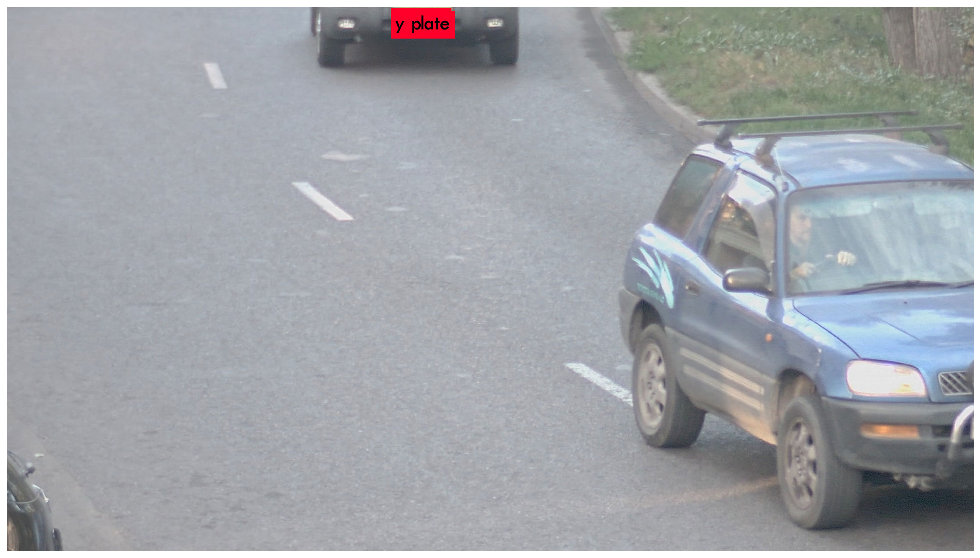

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

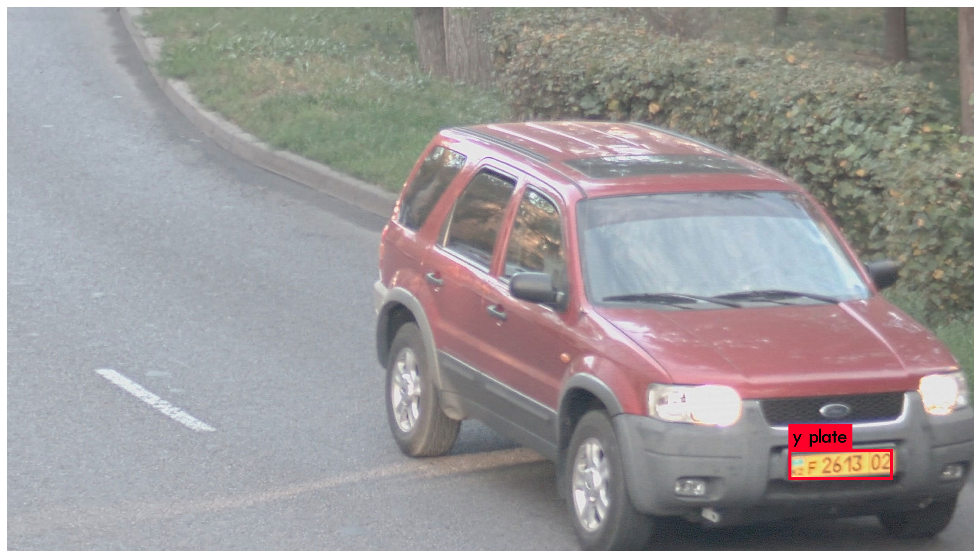

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

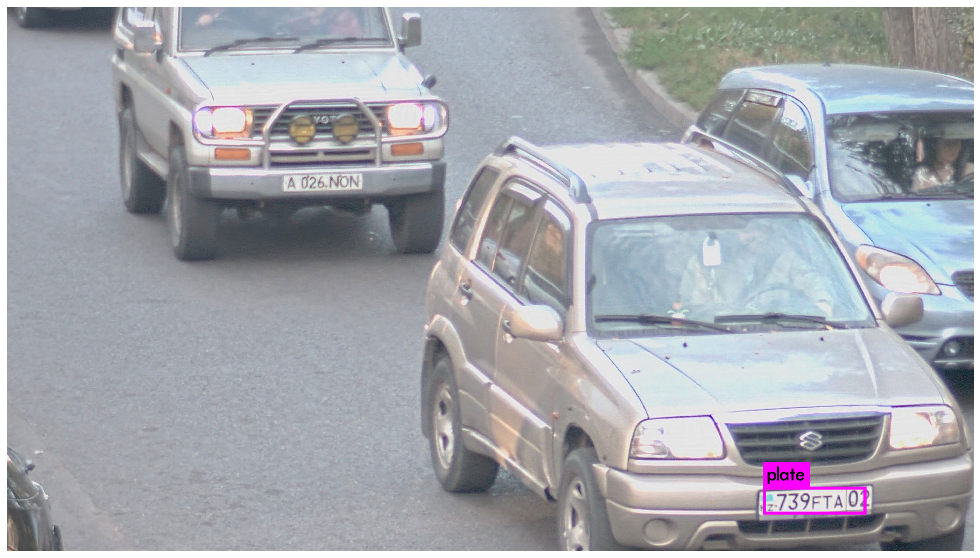

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

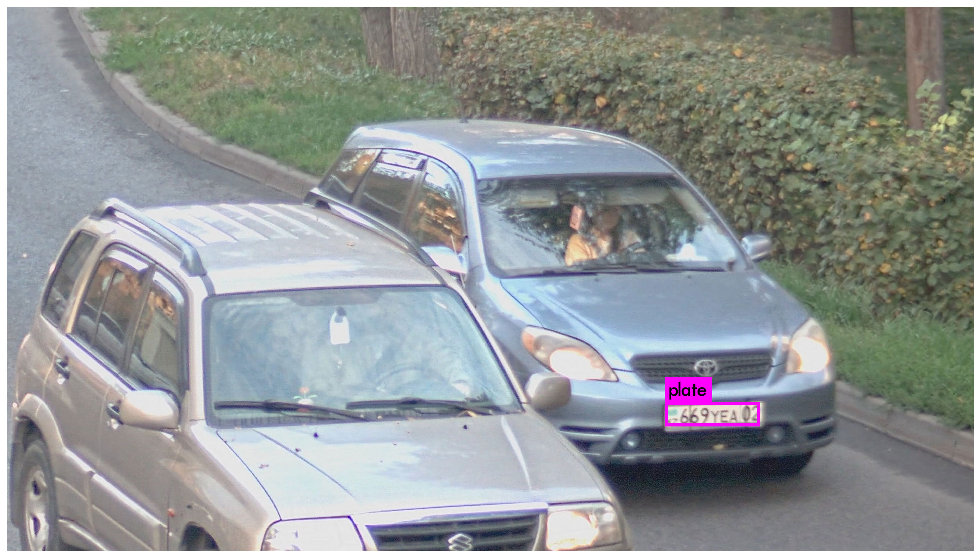

layer     filters    size              input                output
   0 conv     32  3 x 3 / 1   832 x 832 x   3   ->   832 x 832 x  32 1.196 BF
   1 conv     64  3 x 3 / 2   832 x 832 x  32   ->   416 x 416 x  64 6.380 BF
   2 conv     32  1 x 1 / 1   416 x 416 x  64   ->   416 x 416 x  32 0.709 BF
   3 conv     64  3 x 3 / 1   416 x 416 x  32   ->   416 x 416 x  64 6.380 BF
   4 Shortcut Layer: 1
   5 conv    128  3 x 3 / 2   416 x 416 x  64   ->   208 x 208 x 128 6.380 BF
   6 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
   7 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
   8 Shortcut Layer: 5
   9 conv     64  1 x 1 / 1   208 x 208 x 128   ->   208 x 208 x  64 0.709 BF
  10 conv    128  3 x 3 / 1   208 x 208 x  64   ->   208 x 208 x 128 6.380 BF
  11 Shortcut Layer: 8
  12 conv    256  3 x 3 / 2   208 x 208 x 128   ->   104 x 104 x 256 6.380 BF
  13 conv    128  1 x 1 / 1   104 x 104 x 256   ->   104 x 104 x 128 0.709 BF
  14 c

In [0]:
# !./darknet detector map "/content/gdrive/My Drive/darknet/obj.data" "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights"
# !./darknet detector test "/content/gdrive/My Drive/darknet/obj.data" "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" -dont_show < "/content/gdrive/My Drive/darknet/train.txt" > "/content/gdrive/My Drive/darknet/results/result.txt"
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-51-50_430007_55_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-51-54_833195_57_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-51-57_428870_58_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-51-59_718620_62_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-02_638763_1_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-04_245096_0_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-06_372514_2_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-08_511169_3_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-21_119582_7_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-23_836468_12_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-35_035931_16_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-52-54_177567_21_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-10_833514_30_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-13_365998_32_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-19_634979_33_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-39_235667_38_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-46_141994_41_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-54_632770_43_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-53-58_735334_45_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-12_230285_51_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-24_031383_53_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-33_518920_54_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-36_716410_58_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-46_958170_61_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-48_837950_59_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-50_639046_62_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-52_910076_63_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-56_251436_1_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-56_589377_0_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-57_640662_2_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-54-59_345977_6_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-05_921661_9_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-08_956838_11_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-10_958402_12_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-36_250206_22_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-42_915365_24_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-48_189464_27_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-51_161924_28_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-55-58_708629_29_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-00_439323_31_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-12_630722_35_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-14_231978_36_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-16_524013_38_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-21_761434_39_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-51_306802_47_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-55_590159_50_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-55_590159_50_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-57_279762_51_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-56-58_834732_52_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-04_237430_57_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-07_515912_56_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-13_852887_58_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-17_630226_60_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-18_836481_59_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-20_707740_61_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-37_150469_0_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-43_243244_3_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-57-47_722704_6_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-58-09_236349_8_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-58-23_637669_14_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-58-25_031446_15_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-58-38_109999_18_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-58-42_516007_20_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-58-59_724163_25_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-59-02_312423_26_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-59-04_725734_27_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-59-08_824129_29_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-59-11_478861_30_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_07-59-12_918732_31_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-01-01_831711_60_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-01-15_931807_2_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-01-37_181001_11_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-01-38_714411_9_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-02-00_351396_20_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-02-14_151082_26_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-02-23_713977_29_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-02-26_887057_31_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-03-41_318340_49_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-03-43_232548_53_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-03-45_829505_54_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-04-33_916783_2_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-04-35_837384_5_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-05-02_514881_15_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-03_366640_27_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-05_752094_29_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-07_094556_31_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-12_354800_33_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-31_444900_38_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-51_958877_46_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-53_774648_47_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-55_357071_48_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-06-56_711137_49_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-07-37_746422_63_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-07-45_114391_4_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-07-48_959606_5_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-08-19_313006_11_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-09-25_714090_31_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-09-26_711998_32_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-09-36_710376_33_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-09-39_032102_34_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-09-44_438491_42_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-10-18_226540_53_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-10-30_308886_59_rec.jpg" -dont_show
imShow('predictions.jpg')
!./darknet detect "/content/gdrive/My Drive/darknet/cfg/yolov3-spp.cfg" "/content/gdrive/My Drive/darknet/backup/yolov3-spp_final.weights" "/content/gdrive/My Drive/darknet/img_test/2019-10-08_08-10-31_025203_60_rec.jpg" -dont_show
imShow('predictions.jpg')

#Запуск скрипта для тестирования модели на видео
Обработанное видео сохраняется в директорию video_out

In [0]:
%cd "/content/gdrive/My Drive/darknet"
!python yolo_video.py --input "/content/gdrive/My Drive/darknet/video_input/testVideo.mp4" --output  "/content/gdrive/My Drive/darknet/video_input/testVideo.avi" --yolo "/content/gdrive/My Drive/darknet/yolo-coco"

# **ПОИСК НЕИСПРАВНОСТЕЙ**
Основные проблемы, с которыми вы можете столкнуться, если ваша модель выдает ошибку:

**Изображения или файлы не найдены**. Проверьте шпаргалку Yolov3

Если вы неправильно настроили свои фильтры и классы в yolov3.cfg . Проверьте лист Yolov3

Вы можете столкнуться с нехваткой памяти или ошибками библиотеки, главным образом из-за отсутствия некоторых предварительных условий. В этом случае проверьте версии текущих библиотек, установленных на вашей виртуальной машине Colab. 
Вы можете найти больше информации в первых шагах этой записной книжки.
Пакетные параметры и параметры подразделений в вашем yolov3.cfg также могут влиять на распределение памяти. Обратитесь к исходному репо здесь для получения дополнительной информации.
УСТРАНЕНИЕ НЕИСПРАВНОСТЕЙ
Будьте осторожны, если вы готовите свои файлы в Windows. Если вы используете CRLF в своих файлах вместо LF, у вас могут возникнуть проблемы с правильным открытием файлов. - [Satya Shetty](https://twitter.com/satyashetty) for sharing this issue!
